### This notebook contains template code for the following analysis steps:
1) Load nucleus masks
2) Fit 3D mesh to nucleus surface
3) Run nucleus through Flowshape to extract SH coefficients

Install reqs:
```bash
conda create -n nucleus-sh
conda activate nucleus-sh
conda install python=3.10
conda install -c conda-forge numpy scipy jupyterlab scikit-learn scikit-image matplotlib pyvista meshplot plotly notebook pandas
pip install pyacvd pymeshfix libigl zarr glob2 flowshape
```

In [1]:
import flowshape as fs
import numpy as np
import meshplot as mp
import os
import glob2 as glob
import pandas as pd
import zarr
import plotly.express as px
import plotly.graph_objects as go

### Step 1: load in array containing nucleus masks
For now, let's use a sample dataset that lives inside the git repo. Eventually, I can get you access to the full complement of mask datasets (~300 with the fin labeled and another 4000 with just nuclei but no fin labels).

Array size:
(69, 970, 700)
Metadata fields:
['channel_names', 'model_path', 'n_channels', 'n_time_points', 'nuclear_channel', 'prob_levels', 'voxel_size_um', 'zyx_shape']
Voxel size (in microns):


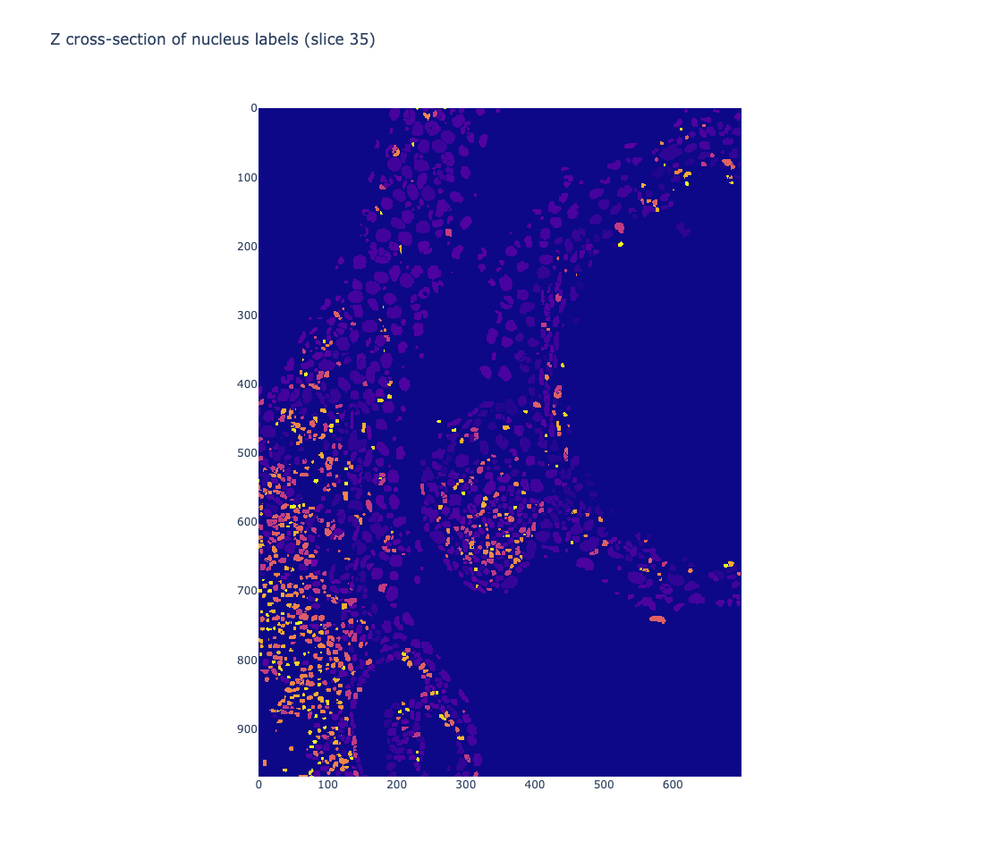

In [19]:
data_root = "../test_data/"
data_name = "20240712_02_well0047" #date-well number
time_point = 0
# load in the mask dataset
mask_zarr = zarr.open(os.path.join(data_root, "zarr_files", data_name + "_mask_aff.zarr"), mode="r")
mask_data = mask_zarr[time_point] # pull an np array

print("Array size:")
data_shape = mask_data.shape
print(data_shape) # tzyx. Note that time dimension is 1 in this case, since this was not a timelapse experiment

# note that the array also contains metadata. Probably the most useful will be the dimensions of each "voxel"
print("Metadata fields:")
print(list(mask_zarr.attrs.keys()))

print("Voxel size (in microns):")
voxel_size = np.asarray(mask_zarr.attrs["voxel_size_um"])

# let's look at a slice
z_slice = 35

# Plot some data (example)
fig = px.imshow(mask_data[z_slice].astype(str),
                title=f"Z cross-section of nucleus labels (slice {z_slice})")

# Update layout to make the image larger
fig.update_layout(
    width=data_shape[2],  # Set width in pixels
    height=data_shape[1]  # Set height in pixels
)

# Hide the colorbar
fig.update_layout(coloraxis_showscale=False)

# Show the plot
fig.show()

Note that the ID assigned to each nucleus is arbitrary: the important thing is that each mask as a unique ID

### Load fin labels
For us, it will be important to be able to seperate out nuclei that are a part of the pec fin. For this, we can use a csv file that has mask (nuclues) IDs paired with their tissue label

In [14]:
# load table with tissue labels using pandas
tissue_label_df = pd.read_csv(os.path.join(data_root, data_name + f"_time{time_point:04}_fin_data.csv"))
tissue_label_df.head()

,Z,Y,X,experiment_date,seg_model,well_num,time_int,fin_curation_flag,nucleus_id,size,...,class_prob_0002,class_prob_0003,label_pd,fin_label_curr,approved_flag,fin_proximity_flag,XP,YP,ZP,yolk_dist
0,34.372203,302.841402,186.890086,20240712_02,tdTom-bright-log-v5,47,0,False,270,2547.0,...,-10.925565,-12.288285,0.0,1.0,False,True,32.869912,9.954898,17.440324,40.133728
1,34.801984,330.617622,177.542775,20240712_02,tdTom-bright-log-v5,47,0,False,271,4083.0,...,-9.320082,-12.328794,0.0,1.0,False,True,4.017695,13.036380,21.579095,50.491772
2,37.369707,246.649144,218.066952,20240712_02,tdTom-bright-log-v5,47,0,False,297,3212.0,...,-7.847054,-10.836822,0.0,1.0,False,True,93.398774,-8.575892,5.976537,11.909106
3,35.932013,265.151601,225.344849,20240712_02,tdTom-bright-log-v5,47,0,False,298,3155.0,...,-9.383162,-11.257378,0.0,1.0,False,True,77.550260,-19.480633,11.200223,15.551537
4,37.174624,277.311028,222.336287,20240712_02,tdTom-bright-log-v5,47,0,False,299,3854.0,...,-10.533051,-11.914111,0.0,1.0,False,True,64.992179,-19.286795,12.039398,17.934540


In [16]:
# theres a lot here, but most isn't relevant to us right now
tissue_df_simp = tissue_label_df.loc[:, ["nucleus_id", "fin_label_curr"]]
print(np.unique(tissue_df_simp["fin_label_curr"]))
tissue_df_simp.head()

[1.]


,nucleus_id,fin_label_curr
0,270,1.0
1,271,1.0
2,297,1.0
3,298,1.0
4,299,1.0


### This dataset contains ONLY nuclei that are considered a part of the fin. We can add other tissue labels later if it makes sense
We can ese this info to generate a tissue label mask. 

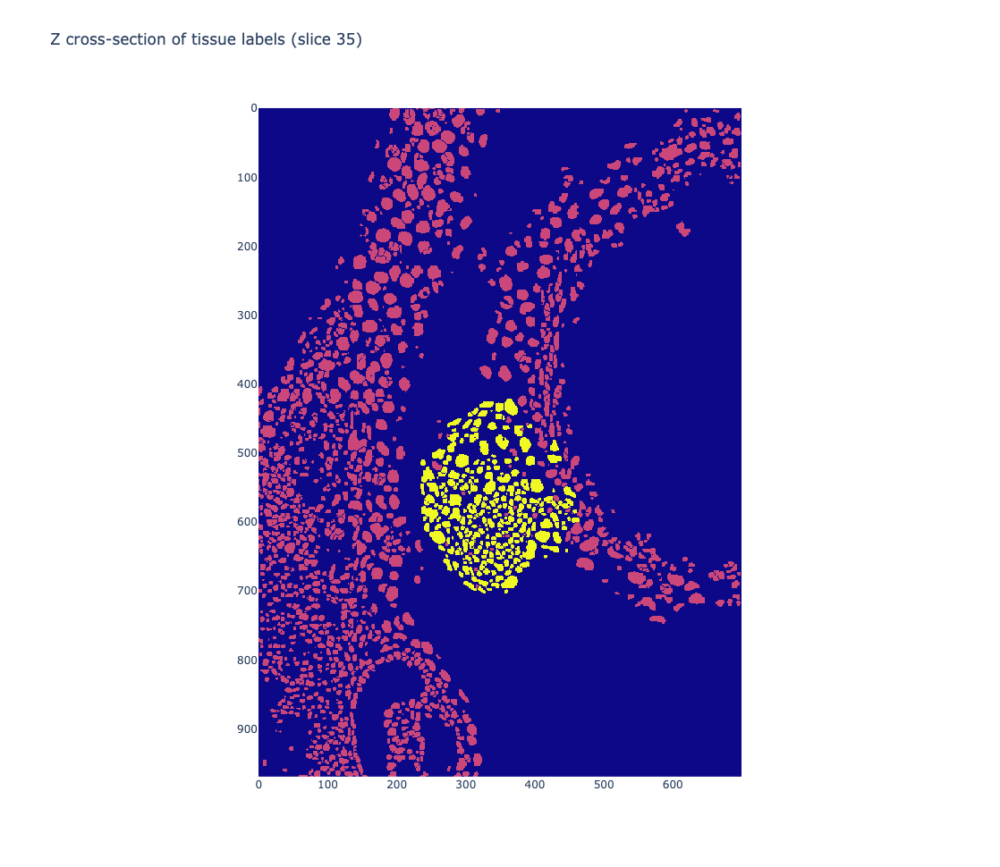

In [18]:
# generate binary vector to use as fin indicator
nucleus_id_vec = np.unique(mask_data) # get all nuclei
nucleus_id_vec = nucleus_id_vec[nucleus_id_vec!=0] # exclude background
fin_nuclei = tissue_df_simp["nucleus_id"].to_numpy()
in_fin_flags = np.isin(nucleus_id_vec, fin_nuclei)

# make a little dataframe for convenience
tissue_df_full = pd.DataFrame(nucleus_id_vec, columns=["nucleus_id"])
tissue_df_full["fin_flag"] = in_fin_flags

# generate a second mask array to visualize as a sanity check
tissue_mask_data = np.zeros_like(mask_data)

tissue_mask_data[mask_data > 0] = 1
tissue_mask_data[np.isin(mask_data, fin_nuclei)] = 2

# let's look at a slice
z_slice = 35

# Plot some data (example)
fig = px.imshow(tissue_mask_data[z_slice].astype(str),
                title=f"Z cross-section of tissue labels (slice {z_slice})")

# Update layout to make the image larger
fig.update_layout(
    width=data_shape[2],  # Set width in pixels
    height=data_shape[1]  # Set height in pixels
)

# Hide the colorbar
fig.update_layout(coloraxis_showscale=False)

# Show the plot
fig.show()

In [7]:
import open3d as o3d

# get raw points
fin_points = fin_df_upsamp[["XP", "YP", "ZP"]].to_numpy()

# convert to point cloud format
pcd = o3d.geometry.PointCloud()
pcd.points = o3d.utility.Vector3dVector(fin_points)

# resample points to be more spatially uniform
min_distance = 0.5
print("Downsampling...")
sampled_points = pcd.voxel_down_sample(voxel_size=min_distance) 
print("Done")

Downsampling...
Done


In [8]:
# import plotly.express as px
# fin_points_u = np.asarray(sampled_points.points)

# fig = px.scatter_3d(x=fin_points_u[:, 0], y=fin_points_u[:, 1], z=fin_points_u[:, 2])
# fig.update_traces(marker=dict(size=3))
# fig.show()

In [9]:
# fit a mesh 
fin_points_u = np.asarray(sampled_points.points)
fin_hull, raw_hull, wt_flag = fit_fin_hull(fin_points_u, alpha=25, n_faces=5000)
print(wt_flag)

False


In [7]:
raw_hull.faces.shape

(10164, 3)

In [10]:
#igl.read_triangle_mesh("/home/nick/projects/flowshape/demo/ABal.obj")
v, f = v, f = fin_hull.vertices.copy(), fin_hull.faces.copy()
mp.plot(v, f, shading = {"wireframe":True})

/home/nick/miniconda3/envs/flowshape_env/lib/python3.10/site-packages/traittypes/traittypes.py:97: UserWarning: Given trait value dtype "float32" does not match required type "float64". A coerced copy has been created.
  warnings.warn(
/home/nick/miniconda3/envs/flowshape_env/lib/python3.10/site-packages/traittypes/traittypes.py:97: UserWarning: Given trait value dtype "uint32" does not match required type "float64". A coerced copy has been created.
  warnings.warn(


Renderer(camera=PerspectiveCamera(children=(DirectionalLight(color='white', intensity=0.6, position=(-2.900268…

### Run spherical mapping

In [11]:
# normalize the scaling of the mesh
v = fs.normalize(v)

# run the spherical mapping flow and mobius centering
sv = fs.sphere_map(v, f)

# Now we have a spherical mesh
mp.plot(sv, f, shading = {"wireframe":True})

Renderer(camera=PerspectiveCamera(children=(DirectionalLight(color='white', intensity=0.6, position=(-0.000649…

### Calculate the mean curvature

In [ ]:
rho = fs.curvature_function(v, sv, f)

mp.plot(v,f, rho )

## SH decomposition

In [ ]:
# this utility does the above steps + SH decomposition
# Here, using maximum degree 24
weights, Y_mat, vs = fs.do_mapping(v,f, l_max = 24)

In [12]:
# This is the array of SH weights
np.set_printoptions(threshold = 100)
print(weights)

[ 3.1985965  -0.14189246 -0.09633128 ...  0.18525062 -0.10537151
  0.13012568]


In [13]:
# Y_mat is a matrix used to convert between weights and mesh function
rho2 = Y_mat.dot(weights)
mp.plot(sv,f, c = rho2)

Renderer(camera=PerspectiveCamera(children=(DirectionalLight(color='white', intensity=0.6, position=(-0.000453…

### Mesh reconstruction

In [14]:
rec2 = fs.reconstruct_shape(sv, f, rho2 )
mp.plot(rec2,f, c = rho2)

Renderer(camera=PerspectiveCamera(children=(DirectionalLight(color='white', intensity=0.6, position=(-0.050321…

### Test with lower frequencies only

In [18]:
weights, Y_mat, vs = fs.do_mapping(v,f, l_max=4)
rec_8 = fs.reconstruct_shape(sv, f, Y_mat.dot(weights) )
mp.plot(rec_8, f, c = rho2)

Renderer(camera=PerspectiveCamera(children=(DirectionalLight(color='white', intensity=0.6, position=(-0.078880…